##TableNet:
###Deep Learning model for end-to-end Table detection and Tabular data extraction from Scanned Document Images

<h1>1.1 Business/Real-world Problem</h1>

With the wide usage of mobile phones and electronic devices in taking photograph of the documents such as Insurance claims, financial invoices etc., and uploading these documents it has become essential in detecting the underlying table and tabular information accurately in an automated fashion in order to reduce the human errors which easily occurs to manual processing of these documents and to reduce the labour costs. TableNet model performs both the tasks of detecting the table in the document and also the table structure togetherly via an end-to-end single model.

<h2>1.2. Problem Statement</h2>

To detect the table present in the document and if present detect the tabular structure from which we extract the table information.

<h2>1.3. Source</h2>


We train our model on the Marmot dataset in which we have annotations for the table mask and table coulmns mask. 
Data Source: https://drive.google.com/drive/folders/1QZiv5RKe3xlOBdTzuTVuYRxixemVIODp

<h2> 1.4. Business objectives and constraints. </h2>

*   No strict low latency as we need to extract the information form the tables can take few seconds.
*   Cost of making errors is high i.e., information extraction need to be accurate.
*   Interpretability has no significance in this case.





<h1> 2. Deep Learning Problem </h1> 

<h2> 2.1. Data </h2> 

<h3> 2.1.1. Data Overview </h3>

The Marmot dataset contains 509 document images in bmp format in which each image contains table. But for only 494 images the annotation of the table and table columns/rows is present in xml format. 

<h2> 2.2. Mapping the real-world problem to an DL problem </h2>

<h3> 2.2.1. Type of Deep Learning Problem </h3>

The problem we are solving is table detection and table information extraction if a table exists i.e., we can frame it as Classification problem in which we are performing the task of predicting whether table exists or not.

<h3>2.2.2. Performance Metric</h3>

We use classification metrics Precision, Recall, F1-Score as our performance metrics for our model.

<h2>2.3. Useful Links </h2>

*   https://arxiv.org/pdf/2001.01469.pdf



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
cd drive/

/content/drive


In [2]:
cd MyDrive/

/content/drive/MyDrive


In [ ]:
%pwd

'/content/drive/MyDrive'

In [ ]:
mkdir Marmot_data

In [ ]:
cd Marmot_data/

/content/drive/My Drive/Marmot_data


In [ ]:
!gdown https://drive.google.com/u/0/uc?id=1Ms3h7oNoWZxR0nnW_1D_Vq9F254wqSXp&export=download

Downloading...
From: https://drive.google.com/u/0/uc?id=1Ms3h7oNoWZxR0nnW_1D_Vq9F254wqSXp
To: /content/drive/My Drive/Marmot_data/Marmot_data.zip
68.8MB [00:01, 54.4MB/s]


In [ ]:
!unzip Marmot_data.zip

<h1> 3. Exploratory Data Analysis </h1>

In [4]:
pip install xmltodict

In [3]:
#importing all the necessary libraries
import os
import cv2
import json
import math
import random
import pathlib
import xmltodict
from PIL import Image,ImageDraw
import xml.dom.minidom
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import xml.etree.ElementTree as ET
import tensorflow as tf
from numpy.random import seed
import warnings
warnings.filterwarnings("ignore")

In [ ]:
cd /content/drive/My Drive/Marmot_data

/content/drive/My Drive/Marmot_data


<h3>3.1. Number of data points/images in Marmot dataset</h3>

In [ ]:
#https://stackoverflow.com/questions/2632205/how-to-count-the-number-of-files-in-a-directory-using-python
print('Number of data points in Marmot dataset: ',len([name for name in os.listdir('.') if os.path.isfile(name)]))

Number of data points in Marmot dataset:  1007


In [ ]:
print('Number of document images in Marmot dataset: ',len([name for name in os.listdir('.')  if name.endswith('.bmp')]))

Number of document images in Marmot dataset:  509


In [ ]:
print('Number of document images in Marmot dataset for which annotations is present: ',len([name for name in os.listdir('.')  if name.endswith('.xml')]))

Number of document images in Marmot dataset for which annotations is present:  495


<h3>Observations</>

*   We observe that Marmot dataset English document images in bmp format with annotations in xml format.
*   This dataset dataset contains 509 document images and annotations of table and table structure(rows and columns) for 495 document images.
*   The dataset contains annotations of ground truth values for both the table and table structure unlike the original Marmot dataset containing annotations with only the ground truth for table detection.


In [ ]:
%pwd

'/content/drive/My Drive/Marmot_data'

<h3>3.2. Loading random image data and its annotation</h3>

size of the image is:  (1056, 816)


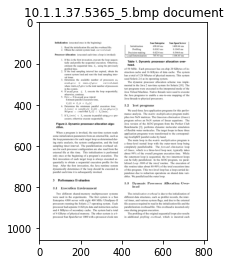

In [ ]:
random.seed(42)
image_name = random.choice([file_name for file_name in os.listdir('/content/drive/My Drive/Marmot_data') if file_name.endswith('.bmp')])
img = cv2.imread(image_name)
height, width = img.shape[:2]
plt.title(image_name + ' document')
plt.imshow(img)
print('size of the image is: ',(height, width))

In [ ]:
dom = xml.dom.minidom.parse(image_name.replace('bmp','xml'))
pretty_xml_as_string = dom.toprettyxml()
print(pretty_xml_as_string)

<?xml version="1.0" ?>
<annotation>
	
	
	<folder>MARMOT_ANNOTATION</folder>
	
	
	<filename>10.1.1.37.5365_5.bmp</filename>
	
	
	<path>/home/monika/Desktop/MARMOT_ANNOTATION/10.1.1.37.5365_5.bmp</path>
	
	
	<source>
		
		
		<database>Unknown</database>
		
	
	</source>
	
	
	<size>
		
		
		<width>816</width>
		
		
		<height>1056</height>
		
		
		<depth>1</depth>
		
	
	</size>
	
	
	<segmented>0</segmented>
	
	
	<object>
		
		
		<name>column</name>
		
		
		<pose>Unspecified</pose>
		
		
		<truncated>0</truncated>
		
		
		<difficult>0</difficult>
		
		
		<bndbox>
			
			
			<xmin>429</xmin>
			
			
			<ymin>94</ymin>
			
			
			<xmax>515</xmax>
			
			
			<ymax>172</ymax>
			
		
		</bndbox>
		
	
	</object>
	
	
	<object>
		
		
		<name>column</name>
		
		
		<pose>Unspecified</pose>
		
		
		<truncated>0</truncated>
		
		
		<difficult>0</difficult>
		
		
		<bndbox>
			
			
			<xmin>543</xmin>
			
			
			<ymin>92</ymin>
			
			
			<xmax>607</xmax>
			
			
			<ymax>170</ymax>
			
		
		</bndbox>
		

<h3>3.3. Annotation of the table coordinates and mapping to Images </h3>

In [ ]:
# this function will take a xml file name as argument converts into json file and returns width, height, table co-ordinates(alongg with the column co-ordinates)
def get_annot(file):
    #loading xml file
    #reference: https://www.geeksforgeeks.org/python-xml-to-json/

    with open(file) as xml_file:
        data_dict = xmltodict.parse(xml_file.read())
        xml_file.close()

        #converting to json
        json_data = json.dumps(data_dict)

        #loading json file
        with open("data.json", "w") as json_file:
            json_file.write(json_data)
            json_dict = json.loads(json_data)
            json_file.close()

    # width of the image
    w = json_dict['annotation']['size']['width']
    # height of the image
    h = json_dict['annotation']['size']['height']

    #getting co-ordinates of table columns
    xmin_lst = []
    ymin_lst = []
    xmax_lst = []
    ymax_lst = []
    for i in json_dict['annotation']['object']:
        if i['bndbox']:
            xmin_lst.append(int(i['bndbox']['xmin']))
            xmax_lst.append(int(i['bndbox']['xmax']))
            ymin_lst.append(int(i['bndbox']['ymin']))
            ymax_lst.append(int(i['bndbox']['ymax']))   
    return w, h, xmin_lst, ymin_lst,xmax_lst,ymax_lst

In [ ]:
#here we are calling the get_annot function for each of the xml file for which its corresponding image is present and storing the returned values into dataframe
doc_img = []
doc_ann = []
xmin_l  = []
xmax_l  = []
ymin_l  = []
ymax_l  = []
width_l = []
height_l = []
data_marmot = pd.DataFrame()

for i,doc in enumerate(tqdm(sorted(os.listdir('/content/drive/My Drive/Marmot_data')))): #for each file
    if doc.endswith('.xml'): #checking if xml file
        if os.path.isfile(doc.replace('xml','bmp')): #getting it's image & checking if it's present
            doc_img.append(doc.replace('xml','bmp'))
            doc_ann.append(doc)
            w, h, xmin_lst, ymin_lst, xmax_lst, ymax_lst = get_annot(doc) #getting the values returned from get_annot function
            xmin_l.append(xmin_lst)
            xmax_l.append(xmax_lst)
            ymin_l.append(ymin_lst)
            ymax_l.append(ymax_lst)
            width_l.append(w)
            height_l.append(h)
#storing all the annotations of each corresponding image where they are mapped to get table mask and column mask
data_marmot['image'] = doc_img
data_marmot['annotation'] = doc_ann
data_marmot['width']  = width_l
data_marmot['height']  = height_l
data_marmot['xmin'] = xmin_l
data_marmot['xmax'] = xmax_l
data_marmot['ymin'] = ymin_l
data_marmot['ymax'] = ymax_l

100%|██████████| 1010/1010 [01:34<00:00, 10.65it/s]


In [ ]:
data_marmot.head()

,image,annotation,width,height,xmin,xmax,ymin,ymax
0,10.1.1.1.2006_3.bmp,10.1.1.1.2006_3.xml,793,1123,"[458, 531, 583, 637]","[517, 568, 619, 670]","[710, 710, 712, 712]","[785, 783, 785, 784]"
1,10.1.1.1.2013_63.bmp,10.1.1.1.2013_63.xml,816,1056,"[118, 316, 387, 456, 526, 597, 665]","[288, 346, 415, 487, 557, 626, 694]","[191, 189, 191, 188, 191, 192, 191]","[766, 764, 764, 764, 764, 763, 764]"
2,10.1.1.1.2013_64.bmp,10.1.1.1.2013_64.xml,816,1056,"[120, 189, 319, 453, 602, 116, 257, 312, 363, ...","[156, 221, 375, 518, 654, 238, 300, 353, 403, ...","[223, 224, 206, 192, 207, 489, 476, 479, 476, ...","[332, 330, 329, 330, 329, 652, 649, 651, 652, ..."
3,10.1.1.1.2014_4.bmp,10.1.1.1.2014_4.xml,816,1056,"[72, 181]","[162, 375]","[264, 263]","[689, 689]"
4,10.1.1.1.2014_6.bmp,10.1.1.1.2014_6.xml,816,1056,"[88, 216, 243]","[175, 232, 334]","[208, 208, 207]","[355, 354, 355]"


In [ ]:
cd ..

/content/drive/My Drive


In [ ]:
data_marmot.to_csv('data_marmot.csv',index=False)

In [ ]:
data_marmot = pd.read_csv('data_marmot.csv')
data_marmot.head()

,image,annotation,width,height,xmin,xmax,ymin,ymax
0,10.1.1.1.2006_3.bmp,10.1.1.1.2006_3.xml,793,1123,"[458, 531, 583, 637]","[517, 568, 619, 670]","[710, 710, 712, 712]","[785, 783, 785, 784]"
1,10.1.1.1.2013_63.bmp,10.1.1.1.2013_63.xml,816,1056,"[118, 316, 387, 456, 526, 597, 665]","[288, 346, 415, 487, 557, 626, 694]","[191, 189, 191, 188, 191, 192, 191]","[766, 764, 764, 764, 764, 763, 764]"
2,10.1.1.1.2013_64.bmp,10.1.1.1.2013_64.xml,816,1056,"[120, 189, 319, 453, 602, 116, 257, 312, 363, ...","[156, 221, 375, 518, 654, 238, 300, 353, 403, ...","[223, 224, 206, 192, 207, 489, 476, 479, 476, ...","[332, 330, 329, 330, 329, 652, 649, 651, 652, ..."
3,10.1.1.1.2014_4.bmp,10.1.1.1.2014_4.xml,816,1056,"[72, 181]","[162, 375]","[264, 263]","[689, 689]"
4,10.1.1.1.2014_6.bmp,10.1.1.1.2014_6.xml,816,1056,"[88, 216, 243]","[175, 232, 334]","[208, 208, 207]","[355, 354, 355]"


In [ ]:
cd Marmot_data/

/content/drive/My Drive/Marmot_data


<h3>3.4. Checking if annotation of the table coordinates and mapping to Images is performed correctly </h3>

Original size of image height and width is:  (1123, 793)
Resized size of image height and width is:  (512, 512)


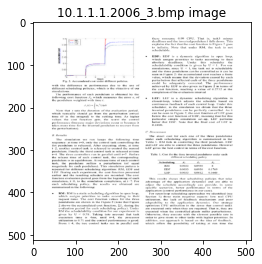

In [ ]:
img = cv2.imread(data_marmot.iloc[0]['image'])
print('Original size of image height and width is: ',img.shape[:2])
#resizing the original image since the proposed model uses fixed size of input image to be of 512 x 512
res_img = cv2.resize(img, (512,512))
plt.title(data_marmot.iloc[0]['image']+' image')
plt.imshow(res_img)
print('Resized size of image height and width is: ',res_img.shape[:2])

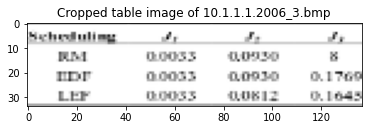

In [ ]:
#here we are getting the cropped table image present in the document
min_x = min([int(i) for i in data_marmot['xmin'][0][1:-1].split(',')]) #starting x co-ordinate
#resizing the x co-ordinate since we have co-ordinate for original size and we have resized to 512 x 512 
min_x = round((512/img.shape[1]) * min_x)
max_x = max([int(i) for i in data_marmot['xmax'][0][1:-1].split(',')]) #ending x co-ordinate
#resizing the x co-ordinate since we have co-ordinate for original size and we have resized to 512 x 512
max_x = round((512/img.shape[1]) * max_x) 
min_y = min([int(i) for i in data_marmot['ymin'][0][1:-1].split(',')]) #starting y co-ordinate
#resizing the y co-ordinate since we have co-ordinate for original size and we have resized to 512 x 512 
min_y = round((512/img.shape[0]) * min_y)
max_y = max([int(i) for i in data_marmot['ymax'][0][1:-1].split(',')]) #ending y co-ordinate
#resizing the y co-ordinate since we have co-ordinate for original size and we have resized to 512 x 512
max_y = round((512/img.shape[0]) * max_y)
crop_img = res_img[min_y:max_y, min_x:max_x].copy()
plt.title('Cropped table image of '+data_marmot.iloc[0]['image'])
plt.imshow(crop_img)

<h3>Observations:</h3>

*   We observe that from xml file with annotation corresponding to the table co-ordinates, the table can be mapped in the document as seen above.
*   We have cropped the table image from the document containing that table..



<h3>3.5. Generating the corresponding table and table-column masks </h3>

In [ ]:
#initializing the table and table-column masks
table_mask = np.zeros((512, 512), dtype=np.int32)
column_mask = np.zeros((512, 512), dtype=np.int32)
#table mask based on the modified co-ordinates
table_mask[min_y:max_y, min_x:max_x] = 255

In [ ]:
#getting the co-ordinates of the table-column mask and modifying the co-ordinates corresponding to 512 x 512 size
col_mask_dict = {}
for i in range(1):
    for col in data_marmot.columns[4:8]:
        col_mask_dict[col] = [int(j) for j in data_marmot[col][i][1:-1].split(',')]
    col_mask_dict['width'] = data_marmot['width'][i]
    col_mask_dict['height'] = data_marmot['height'][i]

In [ ]:
for k in range(0,len(col_mask_dict['xmin'])):
    #table-column mask based on the modified co-ordinates
    column_mask[round((512/col_mask_dict['height']) * col_mask_dict['ymin'][k]):round((512/col_mask_dict['height']) * col_mask_dict['ymax'][k]),round((512/col_mask_dict['width']) * col_mask_dict['xmin'][k]):round((512/col_mask_dict['width']) * col_mask_dict['xmax'][k])] = 255
im_col = Image.fromarray(column_mask.astype(np.uint8),'L')
im_table = Image.fromarray(table_mask.astype(np.uint8),'L')

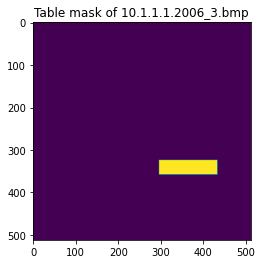

In [ ]:
plt.title('Table mask of '+data_marmot.iloc[0]['image'])
plt.imshow(im_table)

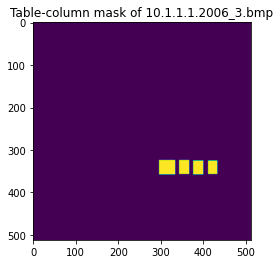

In [ ]:
plt.title('Table-column mask of '+data_marmot.iloc[0]['image'])
plt.imshow(im_col)

<h3>Observations: </h3>

*   We observe that with sucessfully mapping the co-ordinates of the table from the xml file corresponding to each image, created the table, table-column segmented masks.



<h3>3.6. Generating table and table-column masks using the corresponding annotations with their co-ordinates and saving them. </h3>

In [ ]:
root_dir = os.getcwd()

In [ ]:
#this method takes data_marmot dataframe and returns the data_marmot dataframe with additional columns of the paths to the table mask/table-column mask/resized images 
def compute_masks(data_marmot):
    table_save_l =  []
    col_save_l =  []
    resize_image_l = []

    #creating three directories
    op_dir_1 = 'table_mask_512'
    op_dir_2 = 'column_mask_512'
    op_dir_3 = 'resize_image_512'

    #checking if laready these three directories are present and creating them
    if not os.path.exists(root_dir+op_dir_1):
      path = os.path.join(root_dir, op_dir_1)
      os.mkdir(path)

    if not os.path.exists(root_dir+op_dir_2):
      path = os.path.join(root_dir, op_dir_2)
      os.mkdir(path)

    if not os.path.exists(root_dir+op_dir_3):
      path = os.path.join(root_dir, op_dir_3)
      os.mkdir(path)

    for row in tqdm(range(len(data_marmot))): #for each row in the dataframe
        #getting the original image
        img = cv2.imread(data_marmot.iloc[row]['image'])
        #resizing the original image to 512 x 512
        res_img = cv2.resize(img, (512,512))

        #getting the co-ordinates of the table mask and modifying the co-ordinates corresponding to 512 x 512 size
        min_x = min([int(i) for i in data_marmot['xmin'][row][1:-1].split(',')])
        min_x = round((512/img.shape[1]) * min_x)
        max_x = max([int(i) for i in data_marmot['xmax'][row][1:-1].split(',')])
        max_x = round((512/img.shape[1]) * max_x)
        min_y = min([int(i) for i in data_marmot['ymin'][row][1:-1].split(',')])
        min_y = round((512/img.shape[0]) * min_y)
        max_y = max([int(i) for i in data_marmot['ymax'][row][1:-1].split(',')])
        max_y = round((512/img.shape[0]) * max_y)
        crop_img = res_img[min_y:max_y, min_x:max_x].copy()

        #initializing the table and table-column masks
        table_mask = np.zeros((512, 512), dtype=np.int32)
        column_mask = np.zeros((512, 512), dtype=np.int32)

        #table mask based on the modified co-ordinates
        table_mask[min_y:max_y, min_x:max_x] = 255

        #getting the co-ordinates of the table-column mask and modifying the co-ordinates corresponding to 512 x 512 size
        col_mask_dict = {}
        for col in data_marmot.columns[4:8]:
            col_mask_dict[col] = [int(j) for j in data_marmot[col][row][1:-1].split(',')]

        #getting the width and height of original image
        col_mask_dict['width'] = data_marmot['width'][row]
        col_mask_dict['height'] = data_marmot['height'][row]

        for k in range(0,len(col_mask_dict['xmin'])):
            #table-column mask based on the modified co-ordinates
            column_mask[round((512/col_mask_dict['height']) * col_mask_dict['ymin'][k]):round((512/col_mask_dict['height']) * col_mask_dict['ymax'][k]),round((512/col_mask_dict['width']) * col_mask_dict['xmin'][k]):round((512/col_mask_dict['width']) * col_mask_dict['xmax'][k])] = 255
        
        #genertaing table mask
        im_col = Image.fromarray(column_mask.astype(np.uint8),'L')
        #genertaing table-column mask
        im_table = Image.fromarray(table_mask.astype(np.uint8),'L')

        table_save_jpeg = data_marmot.iloc[row]['image'].replace('.bmp','_table_mask')+'.jpeg'
        col_save_jpeg = data_marmot.iloc[row]['image'].replace('.bmp','_col_mask')+'.jpeg'
        resize_save = data_marmot.iloc[row]['image'].replace('.bmp','_resized')+'.jpeg'

        #saving the table, table-column, resized images
        im_table.save('/content/drive/My Drive/Marmot_data/table_mask_512/'+table_save_jpeg)
        im_col.save('/content/drive/My Drive/Marmot_data/column_mask_512/'+col_save_jpeg)
        cv2.imwrite('/content/drive/My Drive/Marmot_data/resize_image_512/'+resize_save,res_img)

        table_save_l.append('table_mask_512/'+table_save_jpeg)
        col_save_l.append('column_mask_512/'+col_save_jpeg)
        resize_image_l.append('resize_image_512/'+resize_save)

    data_marmot['table_mask_512'] = table_save_l
    data_marmot['column_mask_512'] = col_save_l
    data_marmot['resize_image_512'] = resize_image_l

    return data_marmot #returning dataframe with the additional columns with paths of table mask, table-column, resized image

In [ ]:
data_marmot = compute_masks(data_marmot)
data_marmot.head()

100%|██████████| 494/494 [04:50<00:00,  1.70it/s]


,image,annotation,width,height,xmin,xmax,ymin,ymax,table_mask_512,column_mask_512,resize_image_512
0,10.1.1.1.2006_3.bmp,10.1.1.1.2006_3.xml,793,1123,"[458, 531, 583, 637]","[517, 568, 619, 670]","[710, 710, 712, 712]","[785, 783, 785, 784]",table_mask_512/10.1.1.1.2006_3_table_mask.jpeg,column_mask_512/10.1.1.1.2006_3_col_mask.jpeg,resize_image_512/10.1.1.1.2006_3_resized.jpeg
1,10.1.1.1.2013_63.bmp,10.1.1.1.2013_63.xml,816,1056,"[118, 316, 387, 456, 526, 597, 665]","[288, 346, 415, 487, 557, 626, 694]","[191, 189, 191, 188, 191, 192, 191]","[766, 764, 764, 764, 764, 763, 764]",table_mask_512/10.1.1.1.2013_63_table_mask.jpeg,column_mask_512/10.1.1.1.2013_63_col_mask.jpeg,resize_image_512/10.1.1.1.2013_63_resized.jpeg
2,10.1.1.1.2013_64.bmp,10.1.1.1.2013_64.xml,816,1056,"[120, 189, 319, 453, 602, 116, 257, 312, 363, ...","[156, 221, 375, 518, 654, 238, 300, 353, 403, ...","[223, 224, 206, 192, 207, 489, 476, 479, 476, ...","[332, 330, 329, 330, 329, 652, 649, 651, 652, ...",table_mask_512/10.1.1.1.2013_64_table_mask.jpeg,column_mask_512/10.1.1.1.2013_64_col_mask.jpeg,resize_image_512/10.1.1.1.2013_64_resized.jpeg
3,10.1.1.1.2014_4.bmp,10.1.1.1.2014_4.xml,816,1056,"[72, 181]","[162, 375]","[264, 263]","[689, 689]",table_mask_512/10.1.1.1.2014_4_table_mask.jpeg,column_mask_512/10.1.1.1.2014_4_col_mask.jpeg,resize_image_512/10.1.1.1.2014_4_resized.jpeg
4,10.1.1.1.2014_6.bmp,10.1.1.1.2014_6.xml,816,1056,"[88, 216, 243]","[175, 232, 334]","[208, 208, 207]","[355, 354, 355]",table_mask_512/10.1.1.1.2014_6_table_mask.jpeg,column_mask_512/10.1.1.1.2014_6_col_mask.jpeg,resize_image_512/10.1.1.1.2014_6_resized.jpeg


In [ ]:
%pwd

'/content/drive/My Drive/Marmot_data'

<h3>3.7. Checking the original images with their table mask and table-column masks. </h3>

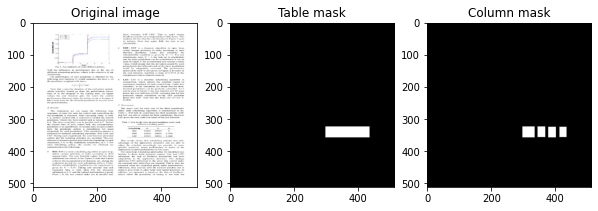

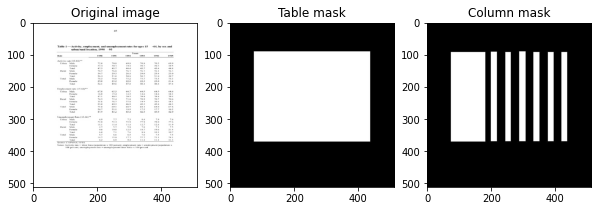

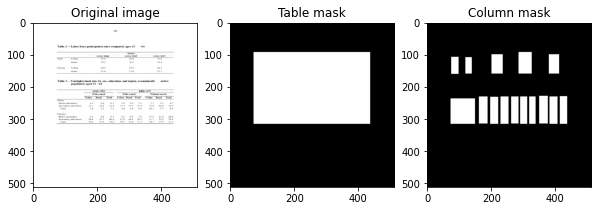

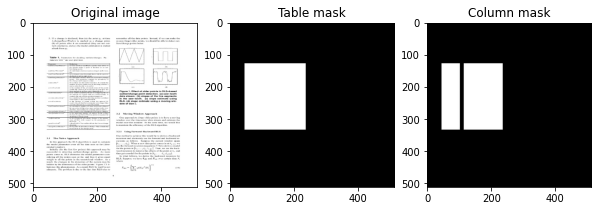

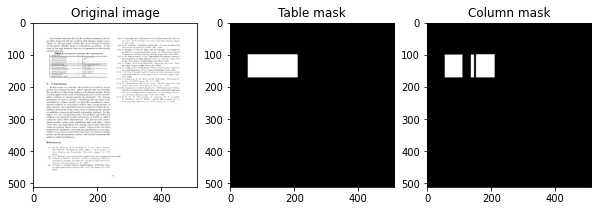

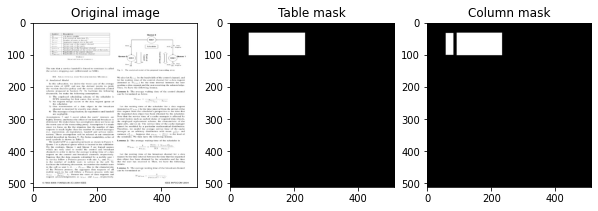

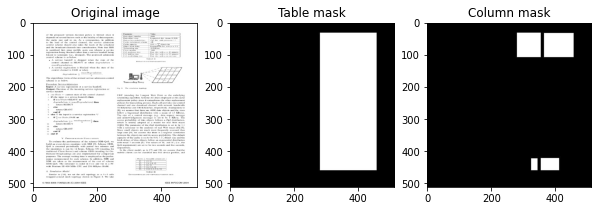

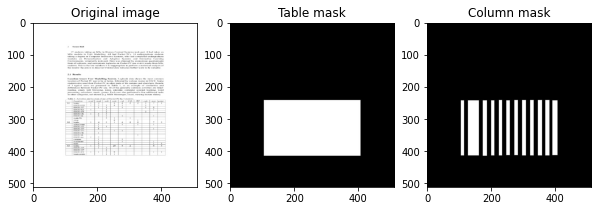

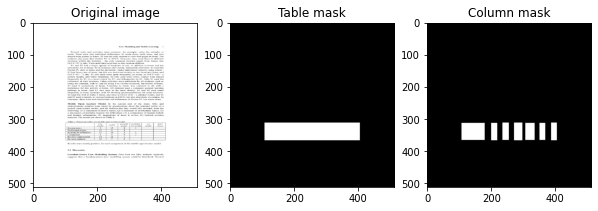

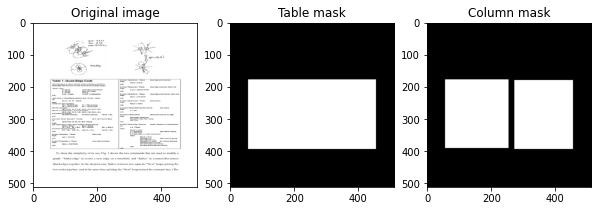

In [ ]:
for i in range(10):
    org_image = cv2.imread(data_marmot.iloc[i]['resize_image_512'])
    table_mask = cv2.imread(data_marmot.iloc[i]['table_mask_512'])
    col_mask = cv2.imread(data_marmot.iloc[i]['column_mask_512'])

    plt.figure(figsize=(10,6))
    plt.subplot(131)
    plt.imshow(org_image)
    plt.title('Original image')
   
    plt.subplot(132)
    plt.imshow(table_mask)
    plt.title('Table mask')

    plt.subplot(133)
    plt.imshow(col_mask)
    plt.title('Column mask')
    plt.show()

In [ ]:
data_marmot.to_csv('data_marmot_with_masks_512.csv',index=False)

<h3>Observations:</h3>

*   With the annotations corresponding to the co-ordinates of table and table-column we generated the respective table and table-column masks of each document image.
*   Saved each of the resized image, table mask and table-column mask in seperate folders under resize_image, table_mask, column_mask respectively.



In [ ]:
data_marmot = pd.read_csv('data_marmot_with_masks_512.csv')
data_marmot.head()

,image,annotation,width,height,xmin,xmax,ymin,ymax,table_mask_512,column_mask_512,resize_image_512
0,10.1.1.1.2006_3.bmp,10.1.1.1.2006_3.xml,793,1123,"[458, 531, 583, 637]","[517, 568, 619, 670]","[710, 710, 712, 712]","[785, 783, 785, 784]",table_mask_512/10.1.1.1.2006_3_table_mask.jpeg,column_mask_512/10.1.1.1.2006_3_col_mask.jpeg,resize_image_512/10.1.1.1.2006_3_resized.jpeg
1,10.1.1.1.2013_63.bmp,10.1.1.1.2013_63.xml,816,1056,"[118, 316, 387, 456, 526, 597, 665]","[288, 346, 415, 487, 557, 626, 694]","[191, 189, 191, 188, 191, 192, 191]","[766, 764, 764, 764, 764, 763, 764]",table_mask_512/10.1.1.1.2013_63_table_mask.jpeg,column_mask_512/10.1.1.1.2013_63_col_mask.jpeg,resize_image_512/10.1.1.1.2013_63_resized.jpeg
2,10.1.1.1.2013_64.bmp,10.1.1.1.2013_64.xml,816,1056,"[120, 189, 319, 453, 602, 116, 257, 312, 363, ...","[156, 221, 375, 518, 654, 238, 300, 353, 403, ...","[223, 224, 206, 192, 207, 489, 476, 479, 476, ...","[332, 330, 329, 330, 329, 652, 649, 651, 652, ...",table_mask_512/10.1.1.1.2013_64_table_mask.jpeg,column_mask_512/10.1.1.1.2013_64_col_mask.jpeg,resize_image_512/10.1.1.1.2013_64_resized.jpeg
3,10.1.1.1.2014_4.bmp,10.1.1.1.2014_4.xml,816,1056,"[72, 181]","[162, 375]","[264, 263]","[689, 689]",table_mask_512/10.1.1.1.2014_4_table_mask.jpeg,column_mask_512/10.1.1.1.2014_4_col_mask.jpeg,resize_image_512/10.1.1.1.2014_4_resized.jpeg
4,10.1.1.1.2014_6.bmp,10.1.1.1.2014_6.xml,816,1056,"[88, 216, 243]","[175, 232, 334]","[208, 208, 207]","[355, 354, 355]",table_mask_512/10.1.1.1.2014_6_table_mask.jpeg,column_mask_512/10.1.1.1.2014_6_col_mask.jpeg,resize_image_512/10.1.1.1.2014_6_resized.jpeg


<h3>Copying all the pre-processed document images, table masks and tabble masks into pre_Marmot_data_512 directory</h3>

In [ ]:
cd ..

/content/drive/My Drive


In [ ]:
mkdir pre_Marmot_data_512

In [ ]:
cd pre_Marmot_data_512/

/content/drive/My Drive/pre_Marmot_data_512


In [ ]:
cp -R /content/drive/My\ Drive/Marmot_data/resize_image_512/ /content/drive/My\ Drive/pre_Marmot_data_512/

In [ ]:
cp -R /content/drive/My\ Drive/Marmot_data/table_mask_512/ /content/drive/My\ Drive/pre_Marmot_data_512/

In [ ]:
cp -R /content/drive/My\ Drive/Marmot_data/column_mask_512/ /content/drive/My\ Drive/pre_Marmot_data_512/

In [ ]:
cd ..

/content/drive/My Drive


In [4]:
%pwd

'/content/drive/My Drive'

<h3>Preparing the train and test data using tf.data</h3>

In [4]:
dir_path = 'pre_Marmot_data_512'
data_root = pathlib.Path(dir_path)
print(data_root)

pre_Marmot_data_512


In [5]:
for i in os.listdir(dir_path):
    print("No of data_points in ",i," sub-directory is ",len(os.listdir(os.path.join(dir_path,i))))

No of data_points in  resize_image_512  sub-directory is  494
No of data_points in  table_mask_512  sub-directory is  494
No of data_points in  column_mask_512  sub-directory is  494


In [6]:
list(data_root.iterdir())

[PosixPath('pre_Marmot_data_512/resize_image_512'),
 PosixPath('pre_Marmot_data_512/table_mask_512'),
 PosixPath('pre_Marmot_data_512/column_mask_512')]

In [7]:
##Getting all image paths
all_image_paths = list(data_root.glob('*/*'))
all_image_paths = [str(path) for path in all_image_paths]
# ##shuffling the images 
# random.shuffle(all_image_paths)

image_count = len(all_image_paths)
image_count

1482

In [8]:
resized_paths = []
table_mask_paths = []
col_mask_paths = []
for path in all_image_paths:
    if path.endswith('resized.jpeg'):
        resized_paths.append(path)
    if path.endswith('table_mask.jpeg'):
        table_mask_paths.append(path)
    if path.endswith('col_mask.jpeg'):
        col_mask_paths.append(path)

In [9]:
len(resized_paths), len(table_mask_paths), len(col_mask_paths)

(494, 494, 494)

In [10]:
test_resize_paths = resized_paths[-math.ceil(len(resized_paths)*0.1):]
train_resize_paths = resized_paths[:-math.ceil(len(resized_paths)*0.1)]

test_table_mask_paths = table_mask_paths[-math.ceil(len(table_mask_paths)*0.1):]
train_table_mask_paths = table_mask_paths[:-math.ceil(len(table_mask_paths)*0.1)]

test_col_mask_paths = col_mask_paths[-math.ceil(len(col_mask_paths)*0.1):]
train_col_mask_paths = col_mask_paths[:-math.ceil(len(col_mask_paths)*0.1)]

In [11]:
(len(train_resize_paths), len(test_resize_paths)), (len(train_table_mask_paths),len(test_table_mask_paths)), (len(train_col_mask_paths),len(test_col_mask_paths))

((444, 50), (444, 50), (444, 50))

<h3>Methods which return train_data and test_data using tf.data pipeline</h3>

In [12]:
def tftrain_generator(images, table_masks, column_masks, is_training, batch_size=32):
    '''Construct a data generator using tf.Dataset'''
    
    def parse_function(image_name,table_name,column_name):
        #reading path 
        image_string = tf.io.read_file(image_name)
        #decoding image
        image = tf.io.decode_jpeg(image_string, channels=3)

        # This will convert to float values in [0, 1]
        image = tf.image.convert_image_dtype(image, tf.float32)
        #resize the image
        image = tf.image.resize(image, [512, 512])

        #reading path 
        table_string = tf.io.read_file(table_name)
        #decoding image
        table_mask = tf.io.decode_jpeg(table_string, channels=1)

        # This will convert to float values in [0, 1]
        table_mask = tf.image.convert_image_dtype(table_mask, tf.float32)
        #resize the image
        table_mask = tf.image.resize(table_mask, [512, 512])

        #reading path 
        column_string = tf.io.read_file(column_name)
        #decoding image
        column_mask = tf.io.decode_jpeg(column_string, channels=1)

        # This will convert to float values in [0, 1]
        column_mask = tf.image.convert_image_dtype(column_mask, tf.float32)
        #resize the image
        column_mask = tf.image.resize(column_mask, [512, 512])
        
        return image, {'table_mask':table_mask,'column_mask':column_mask}
    
    ##creating a dataset from tensorslices
    dataset = tf.data.Dataset.from_tensor_slices((images,table_masks,column_masks))
    
    if is_training:
        dataset = dataset.shuffle(350)  # depends on sample size

    # Transform and batch data at the same time
    dataset = dataset.apply(tf.data.experimental.map_and_batch( parse_function, batch_size,num_parallel_batches=4,  # cpu cores
        drop_remainder=True if is_training else False))
    
    #repeat the dataset indefinitely
    dataset = dataset.repeat()

    #prefetch the data into CPU/GPU
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)

    return dataset

In [13]:
def tftest_generator(images, table_masks, column_masks, is_training, batch_size=2):
    '''Construct a data generator using tf.Dataset'''
    
    def parse_function(image_name,table_name,column_name):
        #reading path 
        image_string = tf.io.read_file(image_name)
        #decoding image
        image = tf.io.decode_jpeg(image_string, channels=3)

        # This will convert to float values in [0, 1]
        image = tf.image.convert_image_dtype(image, tf.float32)
        #resize the image
        image = tf.image.resize(image, [512, 512])

        #reading path 
        table_string = tf.io.read_file(table_name)
        #decoding image
        table_mask = tf.io.decode_jpeg(table_string, channels=1)

        # This will convert to float values in [0, 1]
        table_mask = tf.image.convert_image_dtype(table_mask, tf.float32)
        #resize the image
        table_mask = tf.image.resize(table_mask, [512, 512])

        #reading path 
        column_string = tf.io.read_file(column_name)
        #decoding image
        column_mask = tf.io.decode_jpeg(column_string, channels=1)

        # This will convert to float values in [0, 1]
        column_mask = tf.image.convert_image_dtype(column_mask, tf.float32)
        #resize the image
        column_mask = tf.image.resize(column_mask, [512, 512])
        
        return image, {'table_mask':table_mask,'column_mask':column_mask}
    
    ##creating a dataset from tensorslices
    dataset = tf.data.Dataset.from_tensor_slices((images,table_masks,column_masks))

    if is_training:
        dataset = dataset.shuffle(35)  # depends on sample size

    # Transform and batch data at the same time
    dataset = dataset.apply(tf.data.experimental.map_and_batch( parse_function, batch_size))

    return dataset

In [14]:
train_dataset = tftrain_generator(train_resize_paths,train_table_mask_paths,train_col_mask_paths, is_training=True, batch_size=4)
test_dataset = tftest_generator(test_resize_paths,test_table_mask_paths,test_col_mask_paths, is_training=False, batch_size=1)

Instructions for updating:
Use `tf.data.Dataset.map(map_func, num_parallel_calls)` followed by `tf.data.Dataset.batch(batch_size, drop_remainder)`. Static tf.data optimizations will take care of using the fused implementation.


In [15]:
train_dataset

<PrefetchDataset shapes: ((4, 512, 512, 3), {table_mask: (4, 512, 512, 1), column_mask: (4, 512, 512, 1)}), types: (tf.float32, {table_mask: tf.float32, column_mask: tf.float32})>

In [16]:
test_dataset

<_MapAndBatchDataset shapes: ((None, 512, 512, 3), {table_mask: (None, 512, 512, 1), column_mask: (None, 512, 512, 1)}), types: (tf.float32, {table_mask: tf.float32, column_mask: tf.float32})>

<h3>Modelling: TableNet model (Two Decoders: Decoder_table & Decoder_column) </h3>

In [17]:
class Decoder_table(tf.keras.layers.Layer):
    def __init__(self, kernel=1,  filters=512, name="table_mask"):
        super().__init__(name=name)
        self.filters = filters
        self.kernel = kernel
        self.conv7_table = tf.keras.layers.Conv2D(filters=self.filters, kernel_size=self.kernel, activation='relu',name = 'conv7_table')
        self.table_conv2d = tf.keras.layers.Conv2DTranspose(filters = 3, kernel_size = 3, strides = 2, padding='same', name='table_mask')
        self.upsamp = tf.keras.layers.UpSampling2D(size=(2, 2))

    def call(self, X):
        inputs, pool3, pool4 = X[0], X[1], X[2]
        conv7table = self.conv7_table(inputs)
        conv7table_up = self.upsamp(conv7table)
        conc1 = tf.keras.layers.concatenate(inputs=[conv7table_up,pool4])
        conc1_up = self.upsamp(conc1)
        conc1_up_op = tf.keras.layers.concatenate(inputs=[conc1_up,pool3])
        conc1_up_op_up = self.upsamp(conc1_up_op)
        conc1_up_op_up1 = self.upsamp(conc1_up_op_up)
        table_mask_op = self.table_conv2d(conc1_up_op_up1)
    
        return table_mask_op

In [18]:
class Decoder_column(tf.keras.layers.Layer):
    def __init__(self, kernel=1,  filters=512, name="column_mask"):
        super().__init__(name=name)
        self.filters = filters
        self.kernel = kernel
        self.conv7_column = tf.keras.layers.Conv2D(filters=self.filters, kernel_size=self.kernel, activation='relu',name = 'conv7_column')
        self.conv8_column = tf.keras.layers.Conv2D(filters=self.filters, kernel_size=self.kernel, activation='relu',name = 'conv8_column')
        self.table_col_conv2d = tf.keras.layers.Conv2DTranspose(filters = 3, kernel_size = 3, strides = 2, padding='same', name='table_column_mask')
        self.upsamp = tf.keras.layers.UpSampling2D(size=(2, 2))
        self.drop = tf.keras.layers.Dropout(rate = 0.8)

    def call(self, X):
        inputs, pool3, pool4 = X[0], X[1], X[2]
        conv7column = self.conv7_column(inputs)
        conv7column = self.drop(conv7column)
        conv8column = self.conv8_column(conv7column)

        conv8column_up = self.upsamp(conv8column)
        conc1 = tf.keras.layers.concatenate(inputs=[conv8column_up,pool4])
        conc1_up = self.upsamp(conc1)
        conc1_up_op = tf.keras.layers.concatenate(inputs=[conc1_up,pool3])
        conc1_up_op_up = self.upsamp(conc1_up_op)
        conc1_up_op_up1 = self.upsamp(conc1_up_op_up)
        column_mask_op = self.table_col_conv2d(conc1_up_op_up1)
    
        return column_mask_op

<h3>Encoder which used Vggnet as base network initialised with vgg19 weights and takes Input as Document Image </h3>

In [19]:
X_input = tf.keras.layers.Input(shape=(512, 512, 3))
vgg_19 = tf.keras.applications.VGG19(input_tensor=X_input, include_top=False, weights='imagenet', pooling=None, classes=1000)
pool3 = vgg_19.get_layer('block3_pool').output
pool4 = vgg_19.get_layer('block4_pool').output

conv6 = tf.keras.layers.Conv2D(512, (1, 1), activation = 'relu', name='conv6')(vgg_19.output)
conv6 = tf.keras.layers.Dropout(0.8, name='conv6_dropout')(conv6)

conv6_1 = tf.keras.layers.Conv2D(512, (1, 1), activation = 'relu', name='conv6_1')(conv6)
conv6_1 = tf.keras.layers.Dropout(0.8, name='conv6_1_dropout')(conv6_1)

In [20]:
table_mask = Decoder_table(kernel=1,filters=512)([conv6_1,pool3,pool4])
table_column_mask = Decoder_column(kernel=1,filters=512)([conv6_1,pool3,pool4])

In [21]:
seed(1)
tf.random.set_seed(2)
model = tf.keras.Model(inputs=X_input,outputs=[table_mask, table_column_mask],name="Tablenet")

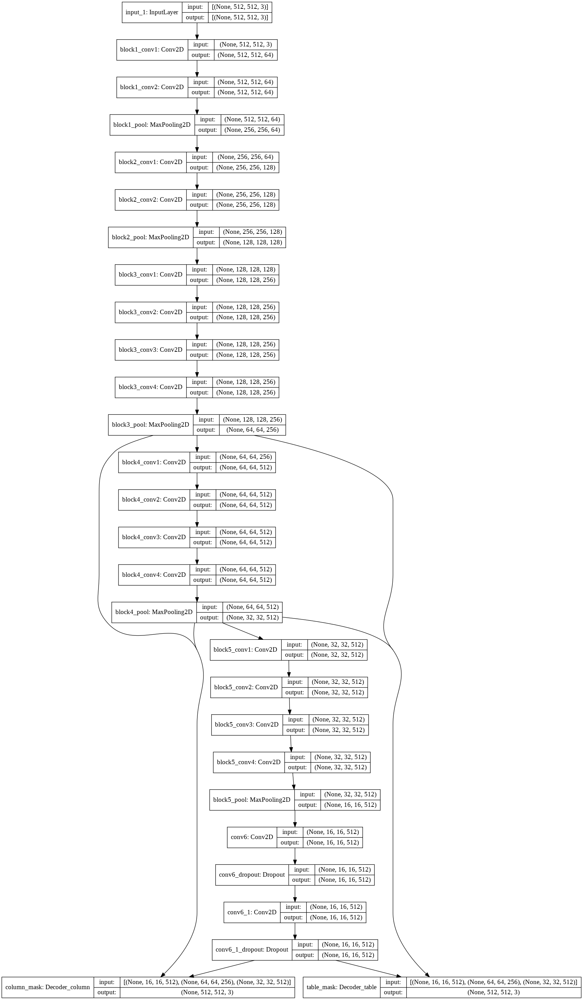

In [22]:
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True)

<h3>Training the Tablenet model </h3>

In [23]:
BATCH_S = 4
losses = {
    "table_mask": tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    "column_mask": tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
}

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),loss=losses,metrics=['accuracy'])

In [24]:
#with reference: https://www.tensorflow.org/guide/keras/custom_callback
class ChangeLearningRate(tf.keras.callbacks.Callback):

    def __init__(self):
        super(ChangeLearningRate, self).__init__
        self.prev_val_loss = -np.Inf

    def on_epoch_end(self, epoch, logs={}):
        lr = float(tf.keras.backend.get_value(self.model.optimizer.learning_rate))
        if (epoch+1) % 10 == 0:
            lr = lr - (lr * 0.02)
        else:
            pass
        if logs['val_loss'] < self.prev_val_loss:
            lr = lr - (lr*0.025)
        else:
            pass
        print('\nLearning rate Changed to:{}'.format(round(lr,4)))
        self.prev_val_loss = logs['val_loss']
        tf.keras.backend.set_value(self.model.optimizer.lr, lr)

In [25]:
import datetime
lrdecay = ChangeLearningRate()
log_dir="tablenet_vgg19_512/logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)
history = model.fit(train_dataset, epochs=50,
                          steps_per_epoch=len(train_resize_paths)//BATCH_S,
                          validation_steps=len(test_resize_paths),
                          validation_data=test_dataset,callbacks=[tensorboard_callback,lrdecay])

Epoch 1/50
111/111 [==============================] - 91s 694ms/step - loss: 2.1301 - table_mask_loss: 1.0145 - column_mask_loss: 1.1156 - table_mask_accuracy: 0.7500 - column_mask_accuracy: 0.8398 - val_loss: 1.0276 - val_table_mask_loss: 0.5093 - val_column_mask_loss: 0.5183 - val_table_mask_accuracy: 0.7961 - val_column_mask_accuracy: 0.8477

Learning rate Changed to:0.001
Epoch 2/50
111/111 [==============================] - 74s 663ms/step - loss: 0.7621 - table_mask_loss: 0.4492 - column_mask_loss: 0.3129 - table_mask_accuracy: 0.7898 - column_mask_accuracy: 0.8716 - val_loss: 0.8679 - val_table_mask_loss: 0.4792 - val_column_mask_loss: 0.3888 - val_table_mask_accuracy: 0.7961 - val_column_mask_accuracy: 0.8477

Learning rate Changed to:0.001
Epoch 3/50
111/111 [==============================] - 74s 663ms/step - loss: 0.7418 - table_mask_loss: 0.4320 - column_mask_loss: 0.3098 - table_mask_accuracy: 0.7763 - column_mask_accuracy: 0.8586 - val_loss: 0.8018 - val_table_mask_loss: 0.

In [26]:
model.save_weights('tablenet_vgg19_512_1.h5')

In [27]:
log_dir

'tablenet_vgg19_512/logs/20210410-113809'

In [28]:
%load_ext tensorboard

In [29]:
%tensorboard --logdir tablenet_vgg19_512/logs/20210410-113809

<IPython.core.display.Javascript object>

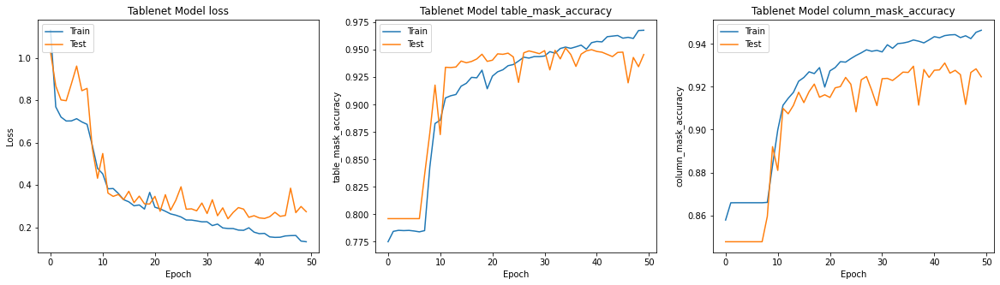

In [30]:
# Plot training & validation loss values
plt.figure(figsize=(20, 5))
plt.subplot(131)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Tablenet Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation accuracy values
plt.subplot(132)
plt.plot(history.history['table_mask_accuracy'])
plt.plot(history.history['val_table_mask_accuracy'])
plt.title('Tablenet Model table_mask_accuracy')
plt.ylabel('table_mask_accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.subplot(133)
plt.plot(history.history['column_mask_accuracy'])
plt.plot(history.history['val_column_mask_accuracy'])
plt.title('Tablenet Model column_mask_accuracy')
plt.ylabel('column_mask_accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.show()

In [24]:
model.load_weights("tablenet_vgg19_512_1.h5")

<h3>Predicted Table and Table-column masks </h3>

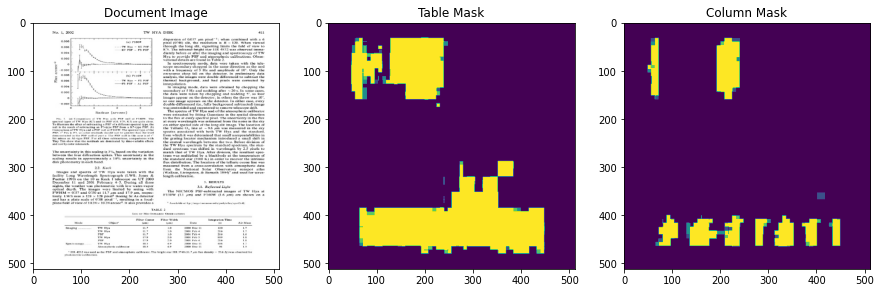

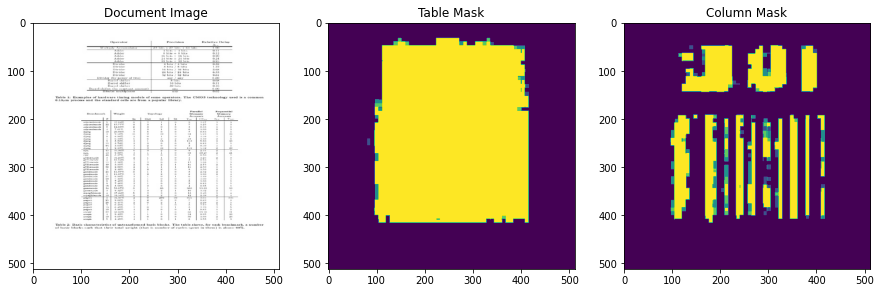

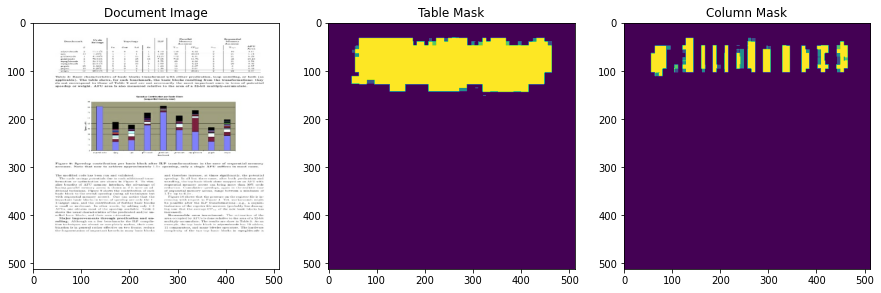

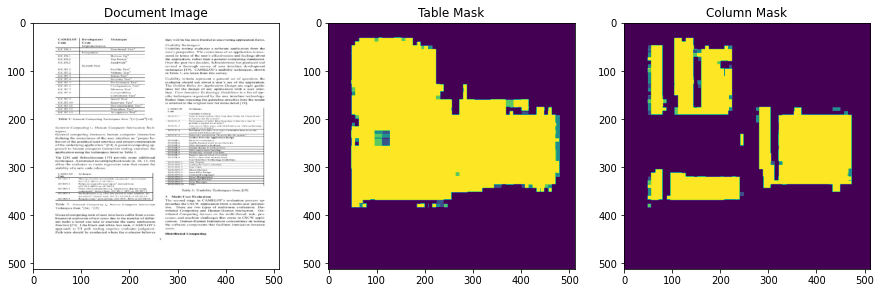

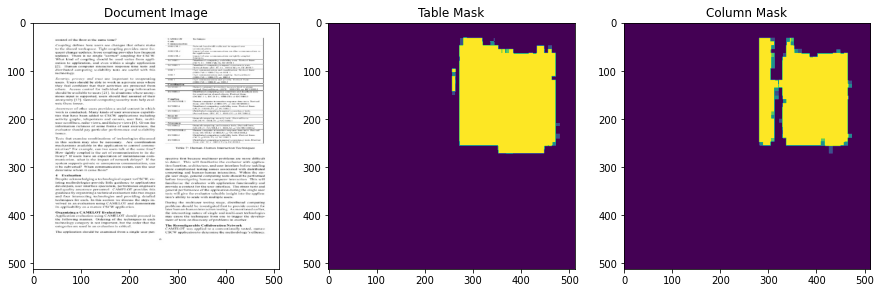

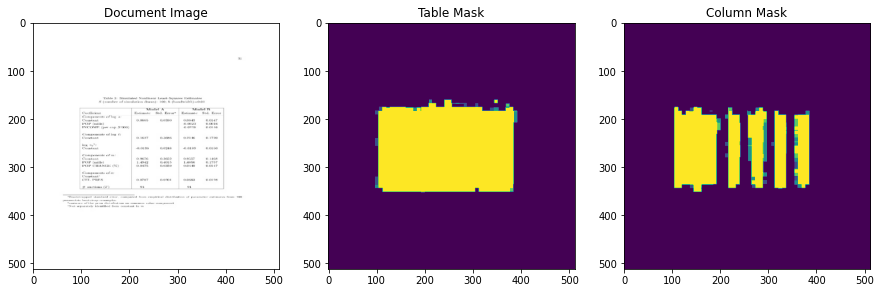

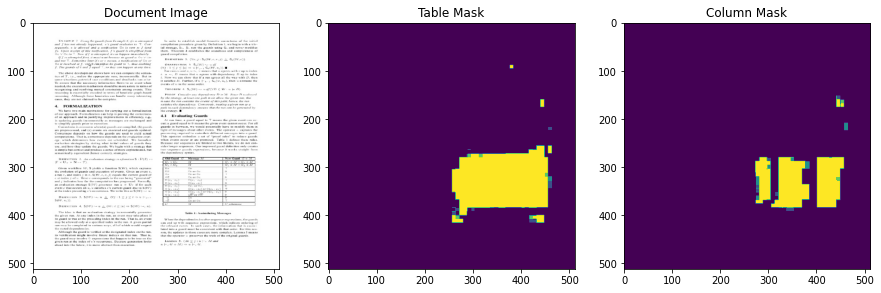

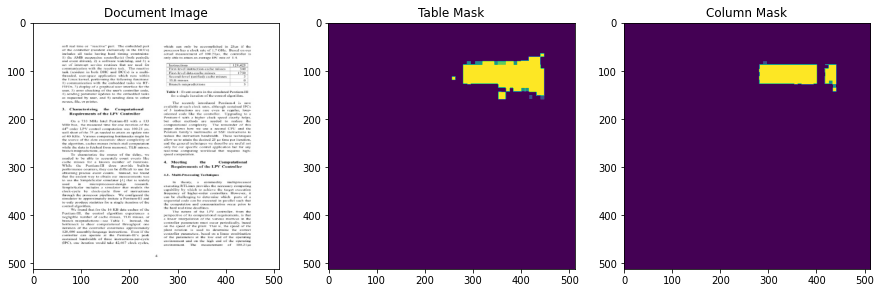

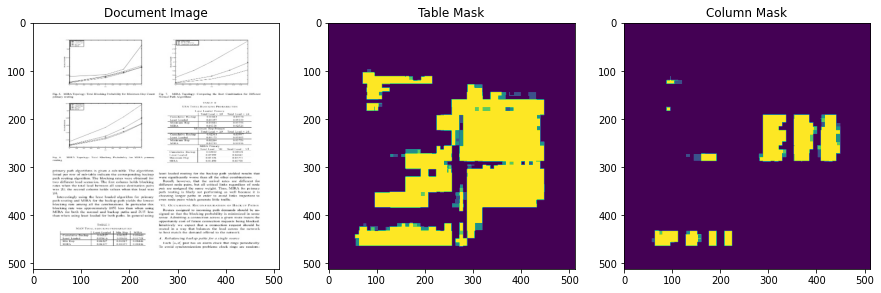

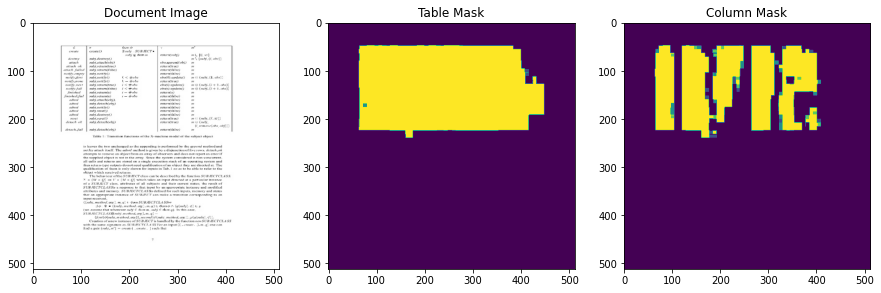

In [32]:
for image, (tablemask, colmask) in test_dataset.take(10):
    pred_tab, pred_col = model.predict(image)

    pred_tab = tf.argmax(pred_tab, axis=-1)
    pred_tab = pred_tab[..., tf.newaxis]
    
    pred_col = tf.argmax(pred_col, axis=-1)
    pred_col = pred_col[..., tf.newaxis]
  
    table_mask, column_mask = pred_tab[0], pred_col[0]
    plt.figure(figsize=(15, 15))

    title = ['Document Image', 'Table Mask', 'Column Mask']
    plot_img = [image[0], table_mask, column_mask]
    for i in range(len(plot_img)):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(plot_img[i]))
    plt.show()

<h3>Computing Precision, Recall and F1-Score </h3>

In [33]:
ground_table_mask = []
ground_table_col_mask = []
pred_table_mask = []
pred_tab_col_mask = []
for image, masks in test_dataset:
    ground_table_mask.append(masks['table_mask'])
    ground_table_col_mask.append(masks['column_mask'])

    pred_tab, pred_col = model.predict(image)

    pred_tab = tf.argmax(pred_tab, axis=-1)
    pred_tab = pred_tab[..., tf.newaxis]
    
    pred_col = tf.argmax(pred_col, axis=-1)
    pred_col = pred_col[..., tf.newaxis]
  
    table_mask, column_mask = pred_tab[0], pred_col[0]

    pred_table_mask.append(table_mask)
    pred_tab_col_mask.append(column_mask)

In [34]:
pred_tabmsk = []
pred_colmsk = []
for tabmsk in pred_table_mask:
    tab_msk = tf.reshape(tabmsk, [1,512, 512])
    pred_tabmsk.append(tab_msk)

for colmsk in pred_tab_col_mask:
    col_msk = tf.reshape(colmsk, [1,512, 512])
    pred_colmsk.append(col_msk)

In [35]:
tab_pre = tf.keras.metrics.Precision()
tab_pre.update_state(ground_table_mask, pred_tabmsk)
table_precision = tab_pre.result().numpy()
print('Precision of table mask prediction is: ',table_precision)

Precision of table mask prediction is:  0.87050635


In [36]:
tab_rec = tf.keras.metrics.Recall()
tab_rec.update_state(ground_table_mask, pred_tabmsk)
table_recall = tab_rec.result().numpy()
print('Recall of table mask prediction is: ',table_recall)

Recall of table mask prediction is:  0.89650154


In [37]:
print('F1-Score of Table mask predicted is on test dataset is: ',(2 * (table_recall * table_precision))/(table_recall+table_precision))

F1-Score of Table mask predicted is on test dataset is:  0.8833127703279611


In [38]:
tabcol_pre = tf.keras.metrics.Precision()
tabcol_pre.update_state(ground_table_col_mask, pred_colmsk)
table_col_precision = tabcol_pre.result().numpy()
print('Recall of table_column mask prediction is: ',table_col_precision)

Recall of table_column mask prediction is:  0.92299104


In [39]:
tabcol_rec = tf.keras.metrics.Recall()
tabcol_rec.update_state(ground_table_col_mask, pred_colmsk)
table_col_recall = tabcol_rec.result().numpy()
print('Recall of table_column mask prediction is: ',table_col_recall)

Recall of table_column mask prediction is:  0.59377074


In [40]:
print('F1-Score of Table_column mask predicted is on test dataset is: ',(2 * (table_col_recall * table_col_precision))/(table_col_recall+table_col_precision))

F1-Score of Table_column mask predicted is on test dataset is:  0.7226515146751842
